<a href="https://colab.research.google.com/github/SSR-ds/NLP-Learnings/blob/main/Sentiment_Analysis_using_Tensorflow_Amazon_review.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!nvidia-smi

Fri Dec 25 17:28:47 2020       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.27.04    Driver Version: 418.67       CUDA Version: 10.1     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla T4            Off  | 00000000:00:04.0 Off |                    0 |
| N/A   47C    P8     9W /  70W |      0MiB / 15079MiB |      0%      Default |
|                               |                      |                 ERR! |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [2]:
!pip uninstall tb-nightly tensorboardX tensorboard
!pip install tf-nightly

Uninstalling tensorboard-2.4.0:
  Would remove:
    /usr/local/bin/tensorboard
    /usr/local/lib/python3.6/dist-packages/tensorboard-2.4.0.dist-info/*
    /usr/local/lib/python3.6/dist-packages/tensorboard/*
Proceed (y/n)? y
  Successfully uninstalled tensorboard-2.4.0
     |████████████████████████████████| 399.2MB 40kB/s 
     |████████████████████████████████| 4.0MB 48.0MB/s 
     |████████████████████████████████| 12.2MB 56.3MB/s 
     |████████████████████████████████| 471kB 57.2MB/s 
ERROR: tensorflow 2.4.0 requires tensorboard~=2.4, which is not installed.
ERROR: tensorflow 2.4.0 has requirement h5py~=2.10.0, but you'll have h5py 3.1.0 which is incompatible.
  Found existing installation: h5py 2.10.0
    Uninstalling h5py-2.10.0:
      Successfully uninstalled h5py-2.10.0


In [3]:
import tensorflow as tf
import tensorflow_datasets as tfds
import os

In [4]:
print(tf.__version__)

2.5.0-dev20201225


In [5]:
dataset, info = tfds.load('amazon_us_reviews/Mobile_Electronics_v1_00', with_info=True)
train_dataset = dataset['train']

Shuffling and writing examples to /root/tensorflow_datasets/amazon_us_reviews/Mobile_Electronics_v1_00/0.1.0.incomplete0DJKVE/amazon_us_reviews-train.tfrecord


Dataset amazon_us_reviews downloaded and prepared to /root/tensorflow_datasets/amazon_us_reviews/Mobile_Electronics_v1_00/0.1.0. Subsequent calls will reuse this data.


In [6]:
info

tfds.core.DatasetInfo(
    name='amazon_us_reviews',
    version=0.1.0,
    description='Amazon Customer Reviews (a.k.a. Product Reviews) is one of Amazons iconic products. In a period of over two decades since the first review in 1995, millions of Amazon customers have contributed over a hundred million reviews to express opinions and describe their experiences regarding products on the Amazon.com website. This makes Amazon Customer Reviews a rich source of information for academic researchers in the fields of Natural Language Processing (NLP), Information Retrieval (IR), and Machine Learning (ML), amongst others. Accordingly, we are releasing this data to further research in multiple disciplines related to understanding customer product experiences. Specifically, this dataset was constructed to represent a sample of customer evaluations and opinions, variation in the perception of a product across geographical regions, and promotional intent or bias in reviews.

Over 130+ million cus

In [7]:
print(train_dataset)

<PrefetchDataset shapes: {data: {customer_id: (), helpful_votes: (), marketplace: (), product_category: (), product_id: (), product_parent: (), product_title: (), review_body: (), review_date: (), review_headline: (), review_id: (), star_rating: (), total_votes: (), verified_purchase: (), vine: ()}}, types: {data: {customer_id: tf.string, helpful_votes: tf.int32, marketplace: tf.string, product_category: tf.string, product_id: tf.string, product_parent: tf.string, product_title: tf.string, review_body: tf.string, review_date: tf.string, review_headline: tf.string, review_id: tf.string, star_rating: tf.int32, total_votes: tf.int32, verified_purchase: tf.int64, vine: tf.int64}}>


In [8]:
len(list(train_dataset))

104975

In [9]:
BUFFER_SIZE = 30000
BATCH_SIZE = 128

In [10]:
train_dataset = train_dataset.shuffle(BUFFER_SIZE, reshuffle_each_iteration=False)

In [11]:
for reviews in train_dataset.take(5):
  print(reviews)

{'data': {'customer_id': <tf.Tensor: shape=(), dtype=string, numpy=b'33293073'>, 'helpful_votes': <tf.Tensor: shape=(), dtype=int32, numpy=11>, 'marketplace': <tf.Tensor: shape=(), dtype=string, numpy=b'US'>, 'product_category': <tf.Tensor: shape=(), dtype=string, numpy=b'Mobile_Electronics'>, 'product_id': <tf.Tensor: shape=(), dtype=string, numpy=b'B002GOQCIC'>, 'product_parent': <tf.Tensor: shape=(), dtype=string, numpy=b'464511643'>, 'product_title': <tf.Tensor: shape=(), dtype=string, numpy=b'Car Remote Keychain - Features High Resolution Photo and Video Recording with Sound. 4gb internal Memory'>, 'review_body': <tf.Tensor: shape=(), dtype=string, numpy=b"Arrived on time and in good condition. The instructions was a little hard to read but no biggy. I was very pleased with the quality that it was. But after 2 weeks of hardly any use, it doesn't work right anymore. Have to use the reset button a lot and when connected to the computer it does not recognize that it is even connected

In [12]:
for reviews in train_dataset.take(20):
  reviews_text = reviews['data']
  print(reviews_text.get('review_body').numpy())
  print(reviews_text.get('star_rating'))
  print(tf.where(reviews_text.get('star_rating')>3,1,0).numpy())

b"Arrived on time and in good condition. The instructions was a little hard to read but no biggy. I was very pleased with the quality that it was. But after 2 weeks of hardly any use, it doesn't work right anymore. Have to use the reset button a lot and when connected to the computer it does not recognize that it is even connected but it does charge......i think. Was very happy with the product until 2 weeks in!"
tf.Tensor(1, shape=(), dtype=int32)
0
b"My daughter picked this out and is very happy with her purchase.  My only hesitation is the ears, because they are floppy if not connected to the back of the case and when they are connected, you can't see the ears."
tf.Tensor(4, shape=(), dtype=int32)
1
b'I bought these being skeptical about how loud they are and i was really satisfied! When i installed these in my garage it had the whole garage shaking. My 1200 watt amp was only half way turned up.'
tf.Tensor(5, shape=(), dtype=int32)
1
b'I love this product because I can walk around l

In [13]:
#set will remove all the duplicates
#tokenization of texts involves breaking of all the words into simple vocabulary form for analysis

tokenizer = tfds.deprecated.text.Tokenizer()

vocabulary_set = set()
for _, reviews in train_dataset.enumerate():
  reviews_text=reviews['data']
  reviews_tokens = tokenizer.tokenize(reviews_text.get('review_body').numpy())
  vocabulary_set.update(reviews_tokens)

  vocabulary_size=len(vocabulary_set)

In [14]:
vocabulary_size

73738

In [15]:
#assinging integer values to the set of words taken through vocabulary set - token text encoder
encoder = tfds.deprecated.text.TokenTextEncoder(vocabulary_set)

In [16]:
print(vocabulary_set)

{'guranteed', 'Dvr', 'supllier', 'Situated', 'reapply', 'holiday', 'Spotter', 'delieverd', 'adafruit', 'Svelte', 'Nigerians', 'Rapala', 'Jeffrey', 'makezine', 'overhere', 'Propeller', 'bowrider', 'locktite', 'ers', 'Supplements', 'vivimos', 'swaddled', 'hauled', 'subdirectories', 'vizio', 'Unstitched', 'Ultrasonic', 'IMPRESSED', 'PLC', 'accidents', 'pickles', 'strong', 'TUA', 'Mindstorms', 'Ace', 'B3', 'spatial', 'Remington', 'SA2008', '950W', 'AutoPC', 'Cms', 'serivce', 'keepin', 'precise', 'IP2', 'forwarding', 'ho', '2Tone', 'TigerDirect', 'Oz', 'DUMMIES', 'Tuneband', 'senses', 'Sumajin', 'wordings', 'Batman', 'retentive', 'belles', 'gadgety', 'Indispensable', 'mo13BYJM0J1RQHA', 'cualquier', 'amazine', 'Tx', 'tad', 'decades', 'KVA', 'OOntZ', 'THINGS', '3600mAH', 'hcp', 'V200', 'T20', 'Dio1978', 'INVESTED', 'FELONY', 'Profile', 'Hawaii', 'vibrate', 'depicted', 'Superstar', 'mismatched', 'aptitude', 'immaterial', 'WCI', 'Powerassist', 'decor', 'SPEECH', 'actuality', 'occured', 'towed',

In [17]:
#getting idea of how it works
for reviews in train_dataset.take(5):
  reviews_text = reviews['data']
  print(reviews_text.get('review_body').numpy())
  encoding_example = encoder.encode(reviews_text.get('review_body').numpy())
  print(encoding_example)

b"Arrived on time and in good condition. The instructions was a little hard to read but no biggy. I was very pleased with the quality that it was. But after 2 weeks of hardly any use, it doesn't work right anymore. Have to use the reset button a lot and when connected to the computer it does not recognize that it is even connected but it does charge......i think. Was very happy with the product until 2 weeks in!"
[40028, 72858, 36974, 15801, 19824, 1977, 44416, 72218, 64205, 15932, 17308, 30935, 23090, 3867, 7137, 65325, 65216, 9494, 53272, 15932, 34783, 65333, 58011, 56101, 55270, 3210, 17106, 15932, 13412, 57991, 47184, 36316, 60301, 17251, 14306, 49002, 17106, 19332, 23758, 25917, 30161, 33520, 26005, 3867, 49002, 56101, 37528, 37853, 17308, 46251, 15801, 62113, 3103, 3867, 56101, 51346, 17106, 35753, 25753, 15745, 3210, 17106, 26879, 41867, 3103, 65325, 17106, 35753, 3429, 11203, 25845, 5940, 34783, 19459, 58011, 56101, 60143, 9275, 47184, 36316, 19824]
b"My daughter picked this ou

In [18]:
for index in encoding_example:
  print('{} ----> {}'.format(index, encoder.decode([index])))

29420 ----> These
27300 ----> cords
26951 ----> have
22630 ----> worked
64987 ----> great


In [19]:
def encode(text_tensor, label_tensor):
  encoded_text = encoder.encode(text_tensor.numpy())
  label = tf.where(label_tensor>3,1,0)
  return encoded_text, label

In [20]:
def encoded_map_fn(tensor):


  text = tensor['data'].get('review_body')
  label=tensor['data'].get('star_rating')

  encoded_text, label = tf.py_function(encode,
                                       inp=[text,label],
                                       Tout=(tf.int64, tf.int32))
  
  return encoded_text, label

In [21]:
encoded_data = train_dataset.map(encoded_map_fn)

In [22]:
for f0,f1 in encoded_data.take(2):
  print(f0)
  print(f1)

tf.Tensor(
[40028 72858 36974 15801 19824  1977 44416 72218 64205 15932 17308 30935
 23090  3867  7137 65325 65216  9494 53272 15932 34783 65333 58011 56101
 55270  3210 17106 15932 13412 57991 47184 36316 60301 17251 14306 49002
 17106 19332 23758 25917 30161 33520 26005  3867 49002 56101 37528 37853
 17308 46251 15801 62113  3103  3867 56101 51346 17106 35753 25753 15745
  3210 17106 26879 41867  3103 65325 17106 35753  3429 11203 25845  5940
 34783 19459 58011 56101 60143  9275 47184 36316 19824], shape=(81,), dtype=int64)
tf.Tensor(0, shape=(), dtype=int32)
tf.Tensor(
[43758 40200 61914 36781 28359 15801 26879 34783 19459 58011 28876 25611
 43758 64865 39631 26879 56101 10506 26378 69732 63723 36719 67691 25753
  3103  3867 56101  9926 60301 56101 17478 15801 62113 69732 63723  3103
 21868  2018 23758 54337 56101 10506], shape=(42,), dtype=int64)
tf.Tensor(1, shape=(), dtype=int32)


In [23]:
len(train_dataset)

104975

In [24]:
TAKE_SIZE=20000

train_data = encoded_data.skip(TAKE_SIZE).shuffle(BUFFER_SIZE)
#train_data = train_data.padded_batch(BATCH_SIZE)

test_data = encoded_data.take(TAKE_SIZE)
#test_data = test_data.padded_batch(BATCH_SIZE)

In [25]:
train_data = train_data.padded_batch(BATCH_SIZE, padded_shapes=([-1],[]))
test_data = test_data.padded_batch(BATCH_SIZE, padded_shapes=([-1],[]))

In [26]:
vocabulary_size += 1

In [27]:
sample_test, sample_label = next(iter(test_data))

In [28]:
sample_test[1], sample_label[1]

(<tf.Tensor: shape=(1789,), dtype=int64, numpy=array([43758, 40200, 61914, ...,     0,     0,     0])>,
 <tf.Tensor: shape=(), dtype=int32, numpy=1>)

In [29]:
for f0,f1 in test_data.take(20):
  print(tf.unique_with_counts(f1)[2].numpy())

[38 90]
[88 40]
[82 46]
[82 46]
[90 38]
[83 45]
[41 87]
[45 83]
[91 37]
[79 49]
[85 43]
[85 43]
[94 34]
[43 85]
[99 29]
[84 44]
[92 36]
[79 49]
[44 84]
[88 40]


In [30]:
import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from tensorflow.keras.models import Sequential, load_model

In [31]:
#we can increase complexity by increasing the layers to get better accuracy and regularization/dropout to reduce overfitting

model = tf.keras.Sequential()
model.add(tf.keras.layers.Embedding(vocabulary_size, 128))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(128, return_sequences=True)))
model.add(tf.keras.layers.Bidirectional(tf.keras.layers.LSTM(64)))


for units in [64, 64]:
  model.add(tf.keras.layers.Dense(units, activation='relu'))

model.add(tf.keras.layers.Dense(1))

In [32]:
!rm -r /tmp/logs/

rm: cannot remove '/tmp/logs/': No such file or directory


In [33]:
import datetime

In [34]:
logdir = os.path.join("/tmp/logs", datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))
tensorboard_callback = tf.keras.callbacks.TensorBoard(logdir, histogram_freq=1)
checkpointer = tf.keras.callbacks.ModelCheckpoint(filepath='/tmp/sentiment_analysis.hdf5', verbose=1, save_best_only=True)

model.compile(optimizer='adam',
              loss=tf.keras.losses.BinaryCrossentropy(from_logits=True),
              metrics=['accuracy'])

In [35]:
hist = model.fit(train_data, epochs=3, validation_data=test_data, callbacks=[tensorboard_callback, checkpointer])

Epoch 1/3
664/664 [==============================] - 6191s 9s/step - loss: 0.4788 - accuracy: 0.7369 - val_loss: 0.2747 - val_accuracy: 0.8780

Epoch 00001: val_loss improved from inf to 0.27473, saving model to /tmp/sentiment_analysis.hdf5
Epoch 2/3
664/664 [==============================] - 5670s 9s/step - loss: 0.2305 - accuracy: 0.9041 - val_loss: 0.2654 - val_accuracy: 0.8945

Epoch 00002: val_loss improved from 0.27473 to 0.26539, saving model to /tmp/sentiment_analysis.hdf5
Epoch 3/3
664/664 [==============================] - 5237s 8s/step - loss: 0.1690 - accuracy: 0.9342 - val_loss: 0.2687 - val_accuracy: 0.8911

Epoch 00003: val_loss did not improve from 0.26539


In [37]:
model.save('/tmp/final_sentiment_analysis.hdf5')

In [39]:
!ls -alrt /tmp/*.hdf5

-rw-r--r-- 1 root root 118634552 Dec 25 20:50 /tmp/sentiment_analysis.hdf5
-rw-r--r-- 1 root root 118634552 Dec 25 22:50 /tmp/final_sentiment_analysis.hdf5


In [40]:
eval_loss, eval_acc = model.evaluate(test_data)

157/157 [==============================] - 332s 2s/step - loss: 0.2687 - accuracy: 0.8911


In [42]:
print('\nEval loss: {:.2f}, Eval accuracy: {:.2f}'.format(eval_loss,eval_acc))


Eval loss: 0.27, Eval accuracy: 0.89


In [43]:
for f0,f1 in test_data.take(2):
  print(f1)
  print(model.predict(f0))

tf.Tensor(
[0 1 1 1 1 0 1 1 1 1 1 1 1 1 1 0 1 0 0 0 0 1 0 1 1 1 0 0 0 1 1 1 1 0 1 0 1
 1 1 1 1 0 1 0 1 1 1 1 0 1 1 1 1 1 0 0 0 1 1 1 1 0 1 0 1 0 1 1 0 1 1 1 1 0
 1 0 1 1 0 0 1 1 1 1 1 0 1 1 1 1 1 1 1 0 0 0 1 1 1 0 0 0 1 0 1 1 1 1 1 1 1
 1 1 1 0 1 1 1 1 0 1 0 1 1 1 1 1 1], shape=(128,), dtype=int32)
[[-1.8846796 ]
 [ 3.1106212 ]
 [ 4.708383  ]
 [ 4.8336253 ]
 [ 4.052017  ]
 [-3.1600442 ]
 [ 5.2789354 ]
 [-2.3875487 ]
 [ 4.4814463 ]
 [ 3.7566416 ]
 [ 5.0712533 ]
 [ 4.839971  ]
 [ 4.252015  ]
 [ 4.801995  ]
 [ 2.46075   ]
 [-1.9287622 ]
 [ 4.587759  ]
 [-1.1341336 ]
 [-1.9899879 ]
 [-4.624763  ]
 [ 4.694688  ]
 [ 2.5633926 ]
 [ 1.0945758 ]
 [ 5.115334  ]
 [-1.1025113 ]
 [ 3.7854533 ]
 [-3.122712  ]
 [-3.0321589 ]
 [-4.4233336 ]
 [ 4.976321  ]
 [ 3.6679833 ]
 [ 2.3852842 ]
 [ 5.225656  ]
 [-4.7571096 ]
 [ 5.085098  ]
 [-5.454312  ]
 [ 0.83404434]
 [ 5.121379  ]
 [ 2.7491453 ]
 [ 1.3026316 ]
 [ 5.2659554 ]
 [ 1.8515409 ]
 [ 3.0787127 ]
 [-4.610715  ]
 [ 2.3942533 ]
 [ 0.8763287 ]
 [ 5.27188

In [44]:
model.layers

In [46]:
model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 128)         9438592   
_________________________________________________________________
bidirectional (Bidirectional (None, None, 256)         263168    
_________________________________________________________________
bidirectional_1 (Bidirection (None, 128)               164352    
_________________________________________________________________
dense (Dense)                (None, 64)                8256      
_________________________________________________________________
dense_1 (Dense)              (None, 64)                4160      
_________________________________________________________________
dense_2 (Dense)              (None, 1)                 65        
Total params: 9,878,593
Trainable params: 9,878,593
Non-trainable params: 0
______________________________________________

In [52]:
model.get_layer('bidirectional').output

<KerasTensor: shape=(None, None, 256) dtype=float32 (created by layer 'bidirectional')>

In [54]:
import matplotlib.pyplot as plt

In [82]:
def plot_graph(history, metric):
  plt.plot(history.history[metric])
  plt.plot(history.history['val_'+metric], '')
  plt.xlabel('epoch')
  plt.ylabel(metric)
  plt.legend([metric, 'val '+metric])
  plt.show()

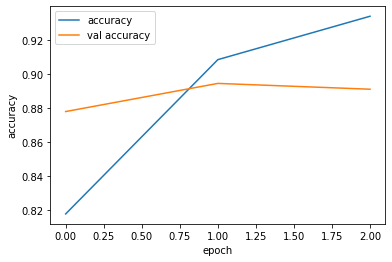

In [83]:
plot_graph(hist, 'accuracy')

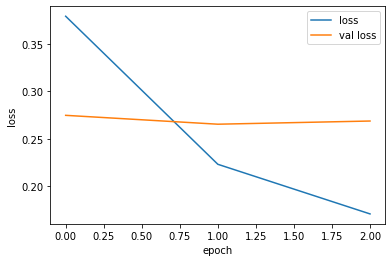

In [84]:
plot_graph(hist, 'loss')

In [85]:
tf.keras.backend.clear_session()

In [86]:
sentimentanalysis_load = tf.keras.models.load_model('/tmp/sentiment_analysis.hdf5', compile=False)

In [87]:
def pad2size(vec, size):
  zeros = [0] * (size - len(vec))
  vec.extend(zeros)
  return vec

In [88]:
def pred_fn(pred_text):
  encoded_pred_text = encoder.encode(pred_text)
  print(encoded_pred_text)
  encoded_pred_text = pad2size(encoded_pred_text, 32)
  print(encoded_pred_text)
  encoded_pred_text = tf.cast(encoded_pred_text, tf.float32)
  pred = sentimentanalysis_load(tf.expand_dims(encoded_pred_text, 0))



  return(pred)

In [90]:
pred_text = ('Fantastic Film , great story telling , good message of peace')
predictions = pred_fn(pred_text)
print(predictions)

[23038, 18357, 64987, 48304, 13948, 1977, 9127, 60301, 18984]
[23038, 18357, 64987, 48304, 13948, 1977, 9127, 60301, 18984, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
tf.Tensor([[3.9598312]], shape=(1, 1), dtype=float32)


In [92]:
pred_text = ('Poorly paced, too long and a really odd story.')
predictions = pred_fn(pred_text)
print(predictions)

[62630, 27038, 54846, 40768, 15801, 17308, 30523, 5282, 48304]
[62630, 27038, 54846, 40768, 15801, 17308, 30523, 5282, 48304, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
tf.Tensor([[-1.9989958]], shape=(1, 1), dtype=float32)


In [93]:
print(tf.distribute.get_strategy())

In [95]:
%reload_ext tensorboard

In [96]:
%tensorboard --logdir /tmp/logs

<IPython.core.display.Javascript object>